In [229]:
%load_ext autoreload
%autoreload 2

from concurrent.futures import ProcessPoolExecutor
import pandas as pd
import numpy as np
from numpy import linalg as LA
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import os
import vaex
from tabulate import tabulate
from arch import arch_model
from utils import *

import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", module="arch")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Data Preprocessing

In [230]:
BINANCE_DATA_PATH = "data/"

TOP_MKT_CAP = ['BTC', 'ETH', 'BNB', 'XRP', 'DOGE', 'ADA', 'MATIC', 'DOT', 'TRX']

crypto_data = {}

for coin in TOP_MKT_CAP:
    data_raw = pd.read_parquet(os.path.join(BINANCE_DATA_PATH, coin + "-USDT.parquet"))
    
    data_raw.index = data_raw.index.rename('date')
    data_raw = resample_data(data_raw, freq='5min')
    data_raw['log_ret'] = np.log(data_raw['close'] / data_raw['open'])

    crypto_data[coin] = data_raw

In [231]:
for coin in TOP_MKT_CAP:
    print(f'{coin} dataset has {len(crypto_data[coin])} rows')

BTC dataset has 552336 rows
ETH dataset has 552321 rows
BNB dataset has 529010 rows
XRP dataset has 477406 rows
DOGE dataset has 354384 rows
ADA dataset has 482352 rows
MATIC dataset has 374508 rows
DOT dataset has 236161 rows
TRX dataset has 466422 rows


# Initial data analysis

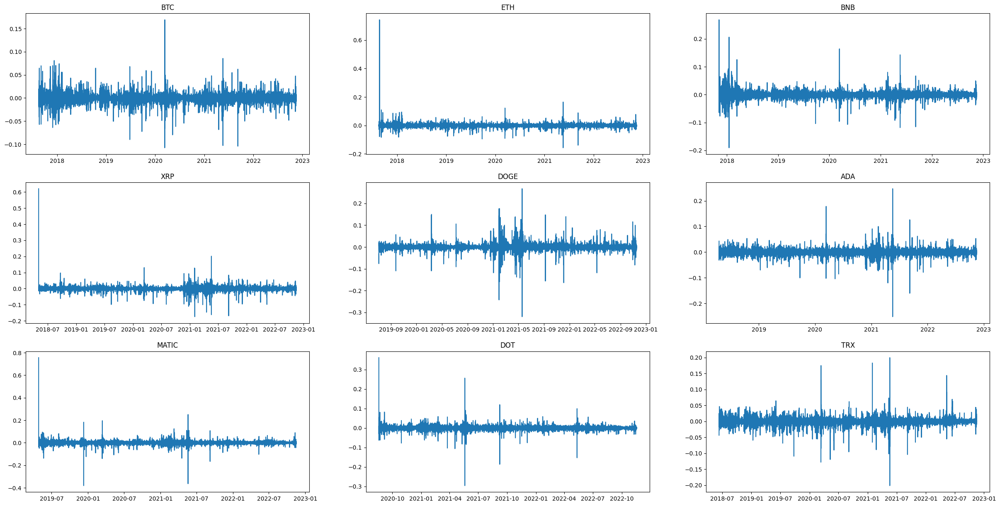

In [232]:
# plot daily log returns
fig, ax = plt.subplots(3, 3, figsize=(30, 15))
ax = ax.flatten()
for i, coin in enumerate(TOP_MKT_CAP):
    ax[i].plot(crypto_data[coin].index, crypto_data[coin]['log_ret'])
    ax[i].set_title(coin)

In [233]:
for coin in TOP_MKT_CAP:
    coin_df = crypto_data[coin]
    vol = {}

    for time in ['h', 'D', 'M', 'Y']:
        df_vol = resample_data(coin_df, freq=time)
        df_vol['ret'] = df_vol['close'] / df_vol['open']
        volatility = df_vol['ret'].dropna().std()
        vol[time] = volatility * 100

    print(tabulate([[coin ,vol['h'], vol['D'],vol['M'], vol['Y']]],headers = ['Hourly Volatility %', 'Daily Volatility %', 'Monthly Volatility %', 'Annual Volatility %'],tablefmt = 'fancy_grid',stralign='center',numalign='center',floatfmt=".2f"))
    print()

╒═════╤═══════════════════════╤══════════════════════╤════════════════════════╤═══════════════════════╕
│     │  Hourly Volatility %  │  Daily Volatility %  │  Monthly Volatility %  │  Annual Volatility %  │
╞═════╪═══════════════════════╪══════════════════════╪════════════════════════╪═══════════════════════╡
│ BTC │         0.92          │         4.12         │         23.50          │        150.68         │
╘═════╧═══════════════════════╧══════════════════════╧════════════════════════╧═══════════════════════╛

╒═════╤═══════════════════════╤══════════════════════╤════════════════════════╤═══════════════════════╕
│     │  Hourly Volatility %  │  Daily Volatility %  │  Monthly Volatility %  │  Annual Volatility %  │
╞═════╪═══════════════════════╪══════════════════════╪════════════════════════╪═══════════════════════╡
│ ETH │         1.21          │         5.24         │         31.99          │        240.19         │
╘═════╧═══════════════════════╧══════════════════════╧═════════

# Crypto Currencies Correlation Analysis

## 1) Pearson Correlation

In [234]:
def compute_pearson_correlation(crypto_1_symbol, crypto_2_symbol):
    # Extract the dataframes from dictionary
    crypto_1_df = crypto_data[crypto_1_symbol].reset_index()
    crypto_2_df = crypto_data[crypto_2_symbol].reset_index()

    merged_crypto = pd.merge(crypto_1_df, crypto_2_df, on='date', how='inner', suffixes=('_1', '_2'))
    merged_crypto.dropna(inplace=True)
    merged_crypto.set_index('date', inplace=True)

    correlation = merged_crypto[['log_ret_1', 'log_ret_2']].corr(method='pearson').iloc[0, 1]

    return correlation, merged_crypto.shape

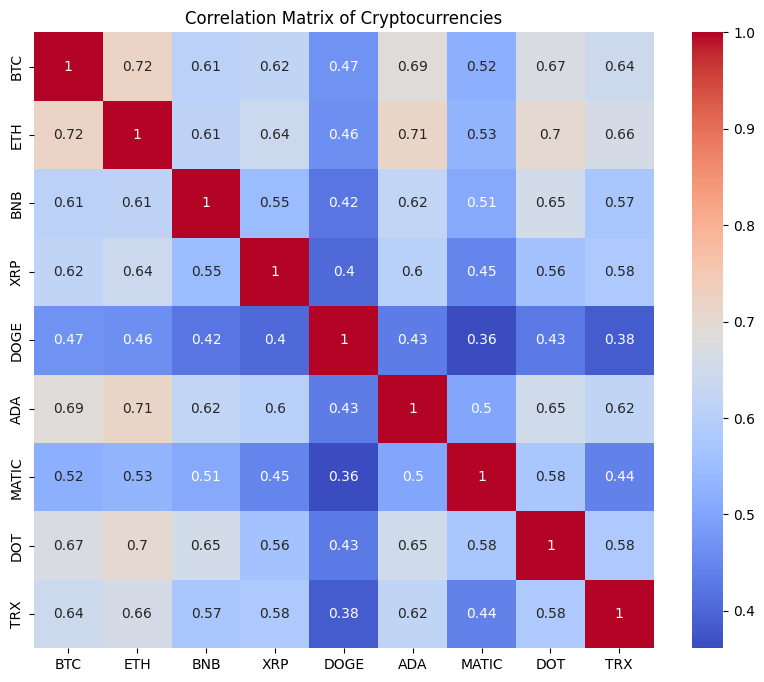

In [235]:
crypto_symbols = list(crypto_data.keys())
num_symbols = len(TOP_MKT_CAP)
window = 72

correlation_matrix = pd.DataFrame(index=crypto_symbols, columns=crypto_symbols)
correlation_observations = []

for i in range(num_symbols - 1):
    for j in range(i+1, num_symbols):
        corr, nb_observation = compute_pearson_correlation(crypto_symbols[i], crypto_symbols[j])
        correlation_matrix.loc[crypto_symbols[i], crypto_symbols[j]] = corr
        correlation_matrix.loc[crypto_symbols[j], crypto_symbols[i]] = corr
        correlation_observations.append(nb_observation)


for symbol in crypto_symbols:
        correlation_matrix.loc[symbol, symbol] = 1


correlation_matrix = correlation_matrix.apply(pd.to_numeric, errors='coerce')

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Cryptocurrencies')
plt.show()

## 2) Eigenvalues clipping

In [236]:
N = correlation_matrix.shape[0]
T = np.mean(correlation_observations)
q = N/T
lambda_plus = (1+np.sqrt(q))**2

l_e, V_e = LA.eig(correlation_matrix)

In [237]:
def eigenvalue_clipping(lambdas, v, lambda_plus):
    N = len(lambdas)
    
    # Calculate delta for eigenvalues below lambda_plus
    delta = np.mean(lambdas[lambdas <= lambda_plus])
    
    # Update eigenvalues below lambda_plus to delta
    lambdas_clean = np.where(lambdas <= lambda_plus, delta, lambdas)
    
    # Reconstruct the cleaned correlation matrix
    C_clean = v @ np.diag(lambdas_clean) @ v.T
    
    # Ensure diagonals are 1 for correlation matrix
    np.fill_diagonal(C_clean, 1)
    
    return C_clean

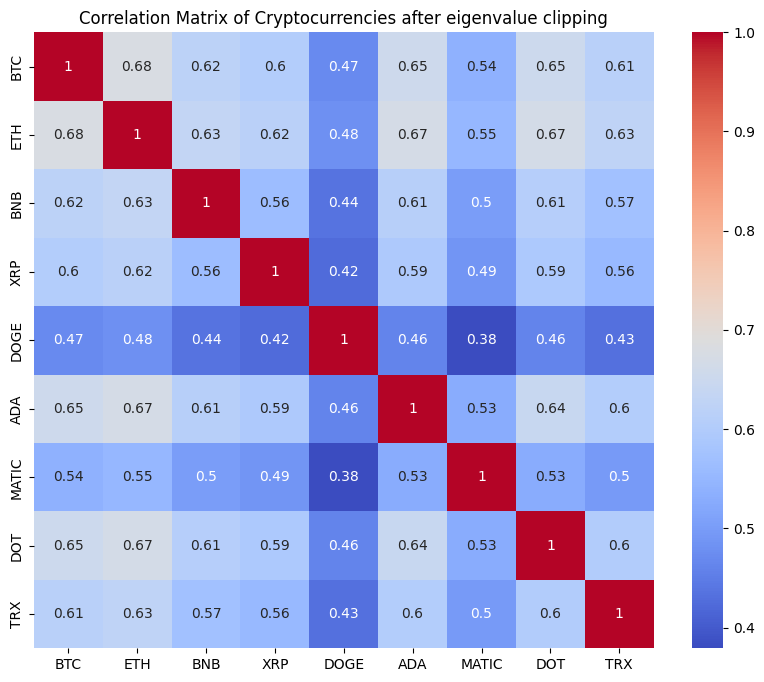

In [238]:
correlation_matrix_clipped = eigenvalue_clipping(l_e, V_e, lambda_plus)
correlation_matrix_clipped = pd.DataFrame(correlation_matrix_clipped, index=crypto_symbols, columns=crypto_symbols)

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix_clipped, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Cryptocurrencies after eigenvalue clipping')
plt.show()

**Before Eigenvalue Clipping:**

- Higher correlation values are evident across most pairs, indicating a stronger linear relationship between the price movements of different cryptocurrencies.

**After Eigenvalue Clipping:**

- The overall correlation levels seem slightly reduced. This may indicate that some of the correlations in the original matrix were inflated due to noise, which eigenvalue clipping has helped mitigate.
- Some of the previously high correlations have decreased, potentially highlighting that certain relationships might have been overestimated due to market noise or non-systematic factors.

**Conclusions:**

- Eigenvalue clipping appears to have smoothed out some of the extreme correlations, which could provide a more stable and reliable understanding of the market structure.
- The adjustment in correlations may help in better portfolio diversification since it potentially offers a clearer view of how assets might truly relate to one another when random noise is reduced.
- The modified matrix might be more useful for risk management purposes as it could more accurately reflect the underlying market dynamics and the true interdependencies between assets.

## 3) Rolling Window Correlation

In [239]:
def rolling_window_correlation(crypto_1_symbol, crypto_2_symbol, window=4):
    # Extract the dataframes from dictionary
    crypto_1_df = crypto_data[crypto_1_symbol].reset_index()
    crypto_2_df = crypto_data[crypto_2_symbol].reset_index()

    # Merge both dataframe to work on the same dates
    crypto_1_df = crypto_1_df[['date', 'log_ret']]
    crypto_2_df = crypto_2_df[['date', 'log_ret']]

    merged_crypto = pd.merge(crypto_1_df, crypto_2_df, on='date', how='inner', suffixes=('_1', '_2'))
    merged_crypto.dropna(inplace=True)
    merged_crypto.set_index('date', inplace=True)

    # Calcualte rolling correlation
    rolling_corr = merged_crypto.rolling(window=window).corr()
    rolling_corr.index.names = ['date', 'return']
    rolling_corr.reset_index(level='return', inplace=True)
    rolling_corr.dropna(inplace=True)

    # Extract the correlation
    rolling_corr = rolling_corr[rolling_corr['return'] == 'log_ret_2']['log_ret_1']
    rolling_corr.rename('correlation', inplace=True)
    
    return rolling_corr

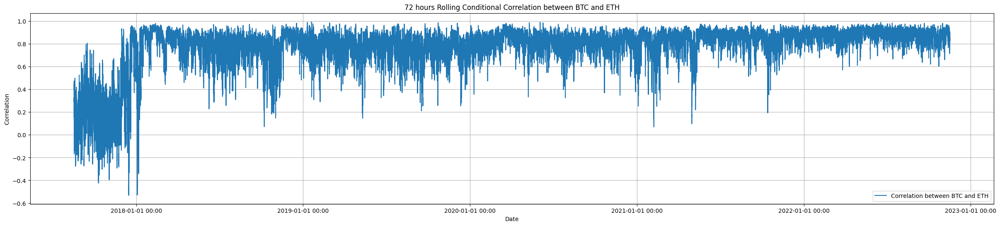

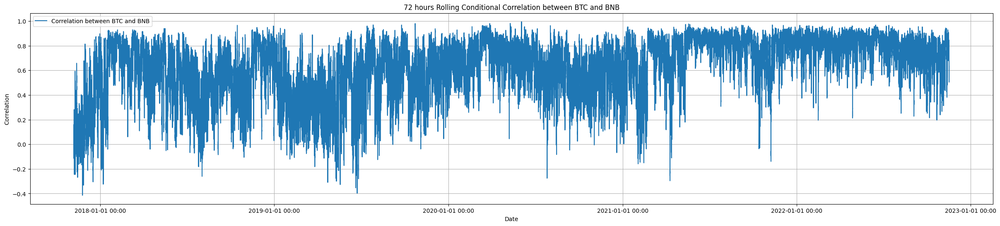

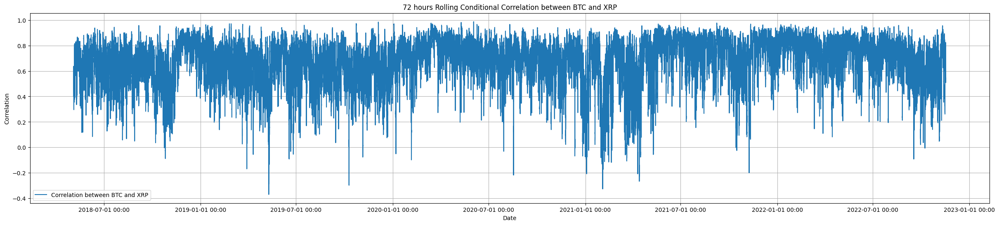

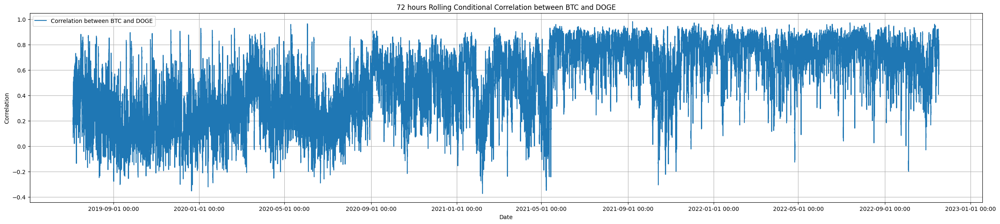

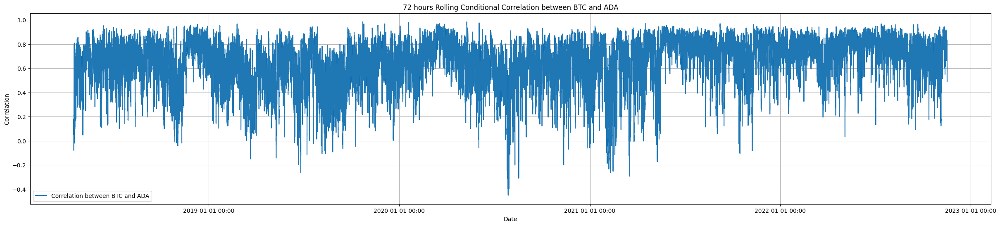

...

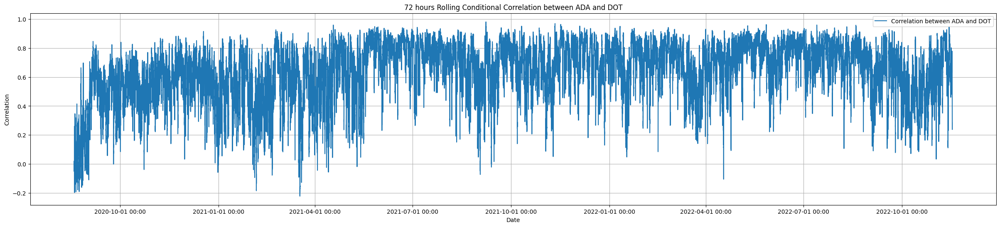

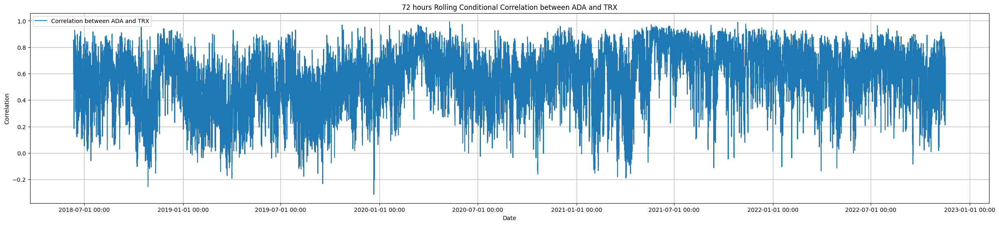

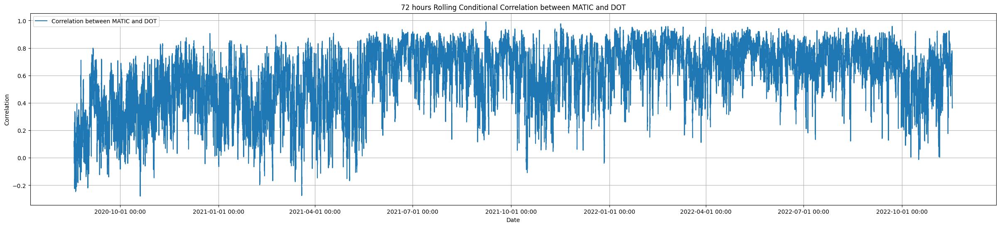

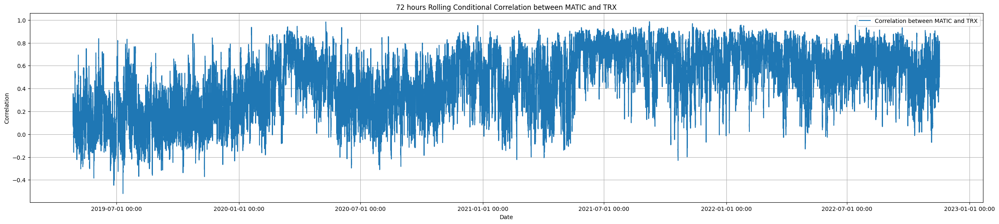

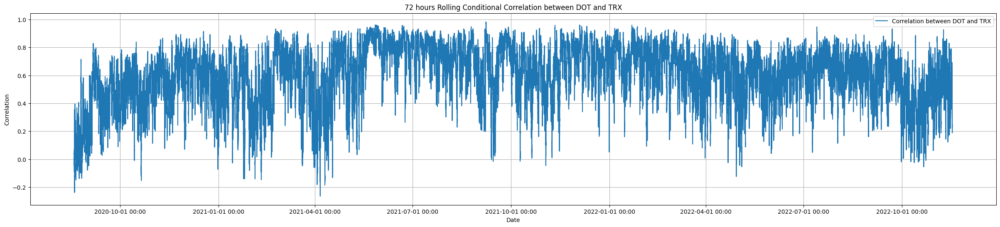

In [240]:
rolling_correlations = {}

crypto_symbols = list(crypto_data.keys())
num_symbols = len(TOP_MKT_CAP)
window = 72

for i in range(num_symbols - 1):
    for j in range(i+1, num_symbols):
        crypto_1_symbol = crypto_symbols[i]
        crypto_2_symbol = crypto_symbols[j]

        rol_corr = rolling_window_correlation(crypto_1_symbol, crypto_2_symbol, window=window)
        rolling_correlations[(crypto_1_symbol, crypto_2_symbol)] = rol_corr
        
        # Visiluasation
        plt.figure(figsize=(30, 6))
        plt.plot(rol_corr.index, rol_corr, label=f'Correlation between {crypto_1_symbol} and {crypto_2_symbol}')
        plt.title(f'{window} hours Rolling Conditional Correlation between {crypto_1_symbol} and {crypto_2_symbol}')
        plt.xlabel('Date')
        plt.ylabel('Correlation')
        plt.legend()
        plt.grid(True)

        # Formatting Date on X-axis
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
        plt.show()
        

## 4) Dynamic Conditional Correlation (DCC)

In [241]:
def compute_dynamic_conditional_correlation(crypto_1_symbol, crypto_2_symbol):
    # Extract the dataframes from dictionary
    crypto_1_df = crypto_data[crypto_1_symbol].reset_index()
    crypto_2_df = crypto_data[crypto_2_symbol].reset_index()

    # Merge both dataframe to work on the same dates
    crypto_1_df = crypto_1_df[['date', 'log_ret']]
    crypto_2_df = crypto_2_df[['date', 'log_ret']]

    merged_crypto = pd.merge(crypto_1_df, crypto_2_df, on='date', how='inner', suffixes=('_1', '_2'))
    merged_crypto.dropna(inplace=True)

    crypto_1_log_return = merged_crypto['log_ret_1']
    crypto_2_log_return = merged_crypto['log_ret_2']

    # Fit GARCH models
    garch1 = arch_model(crypto_1_log_return, p=1, q=1, rescale=False).fit(disp='off')
    garch2 = arch_model(crypto_2_log_return, p=1, q=1, rescale=False).fit(disp='off')

    # Extract standardized residuals
    std_resid1 = garch1.resid / garch1.conditional_volatility
    std_resid2 = garch2.resid / garch2.conditional_volatility

    std_resid1 = list(std_resid1)
    std_resid2 = list(std_resid2)

    # Compute the unconditional correlation matrix
    uncond_corr = np.corrcoef(std_resid1, std_resid2)

    # Initialize parameters for the DCC model
    alpha = 0.01
    beta = 0.98

    # Initialize matrices to store results
    T = len(std_resid1)
    Q = np.zeros((T, 2, 2))
    R = np.zeros_like(Q)
    Q[0] = uncond_corr
    R[0] = uncond_corr

    # Estimate the dynamic correlation
    for t in range(1, T):
        u = np.array([std_resid1[t], std_resid2[t]]).reshape(-1, 1)
        Q[t] = (1 - alpha - beta) * uncond_corr + alpha * u @ u.T + beta * Q[t - 1]

        Qt_inv_sqrt = np.diag(1 / np.sqrt(np.diag(Q[t])))
        Rt = Qt_inv_sqrt @ Q[t] @ Qt_inv_sqrt
        R[t] = Rt

    # Extract dynamic correlations
    dynamic_correlations = np.array([R[t, 0, 1] for t in range(T)])
    dynamic_correlations = pd.DataFrame(dynamic_correlations, index=merged_crypto['date'].to_list(), columns=['dcc_correlation'])
    dynamic_correlations.index.rename('date', inplace=True)

    return dynamic_correlations


/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


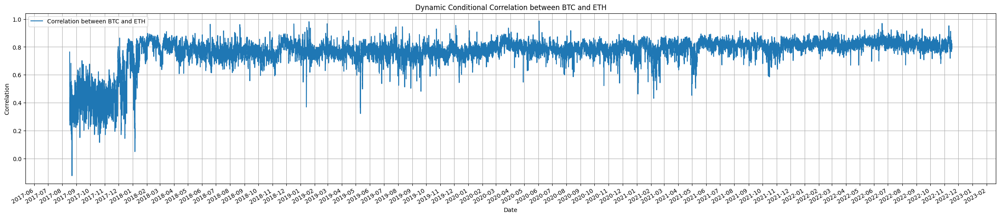

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


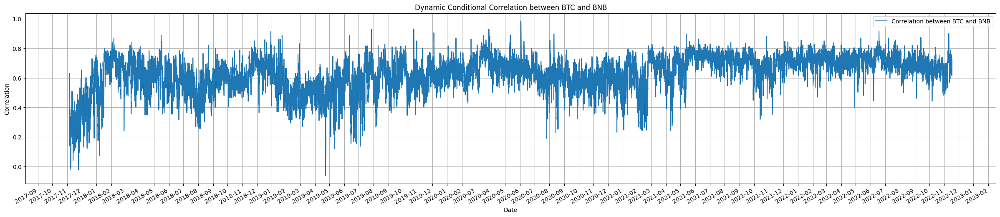

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


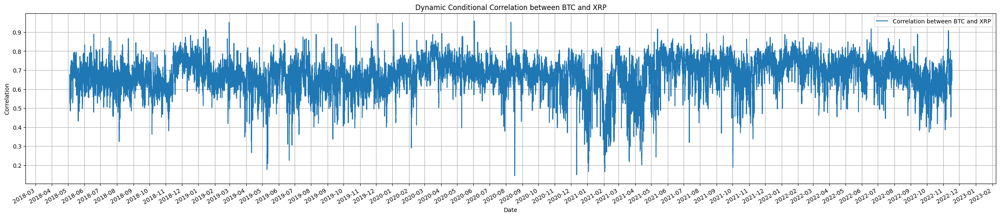

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


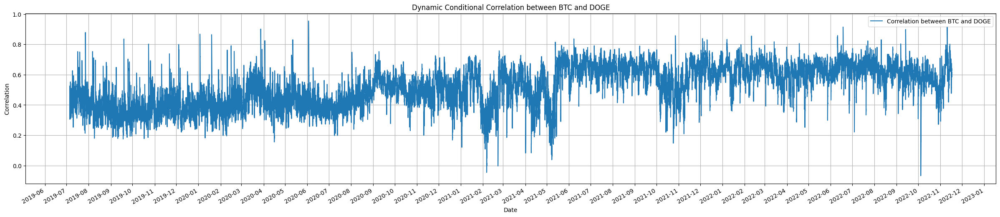

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


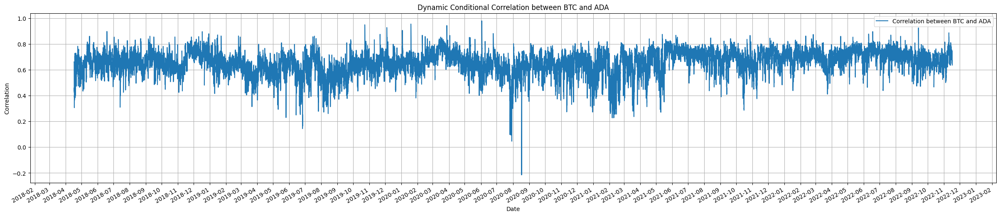

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


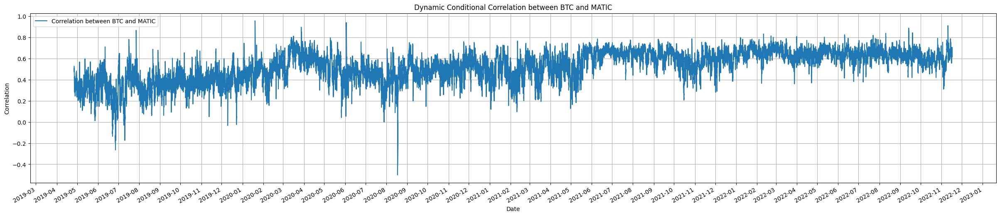

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


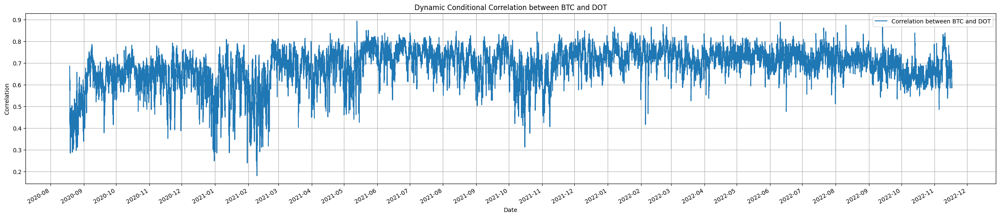

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


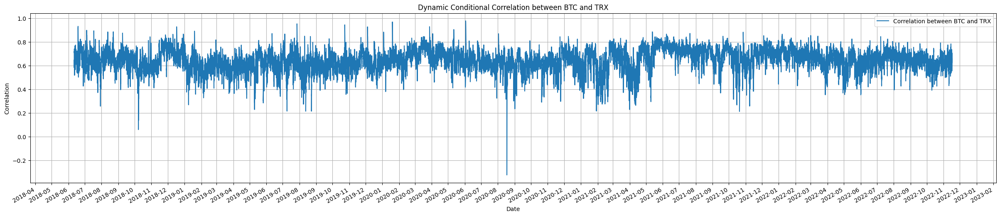

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


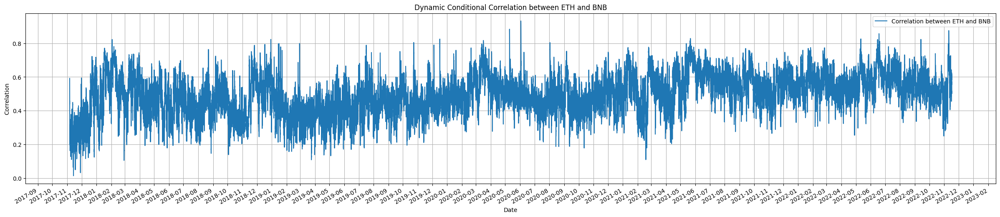

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


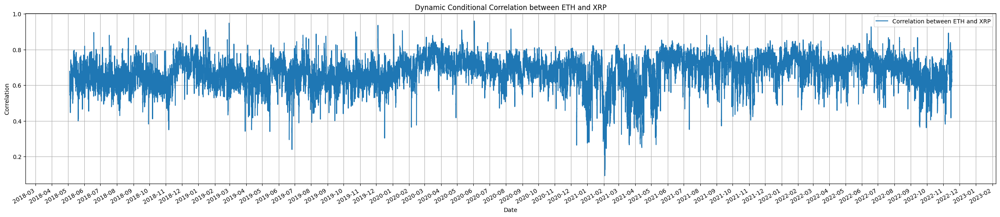

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


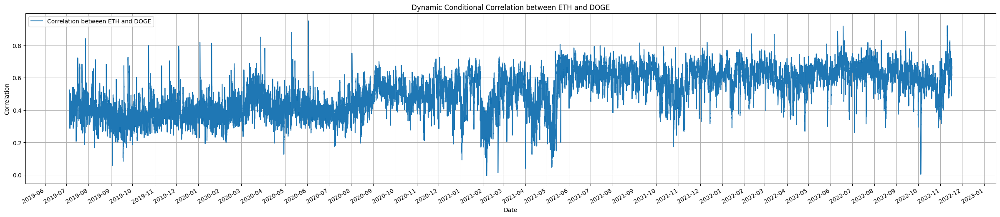

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


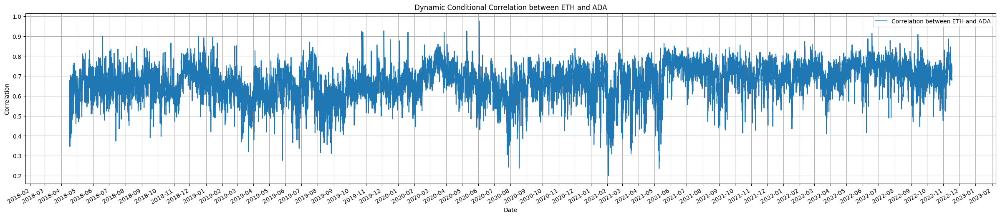

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


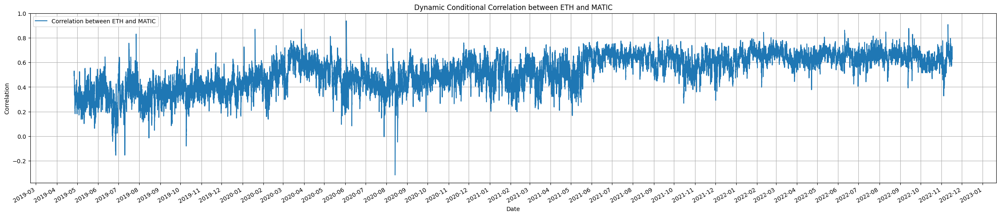

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


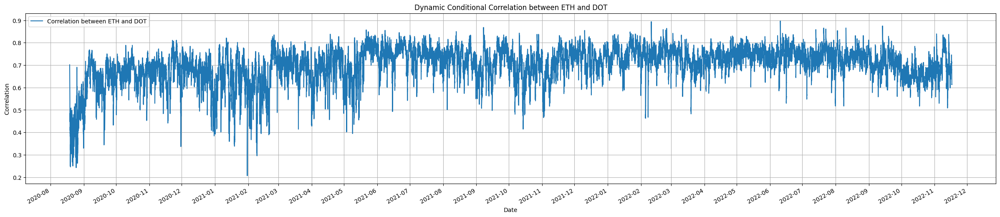

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


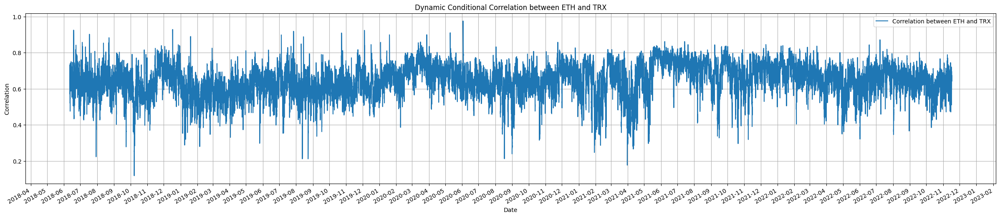

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


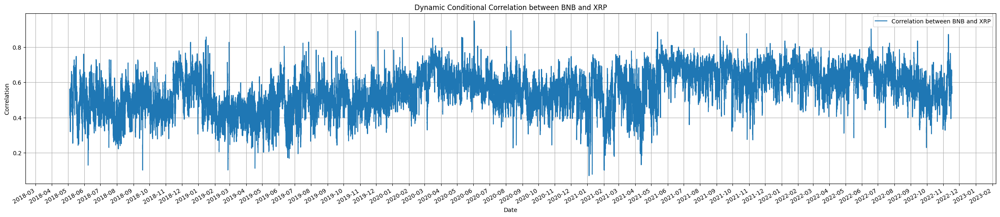

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


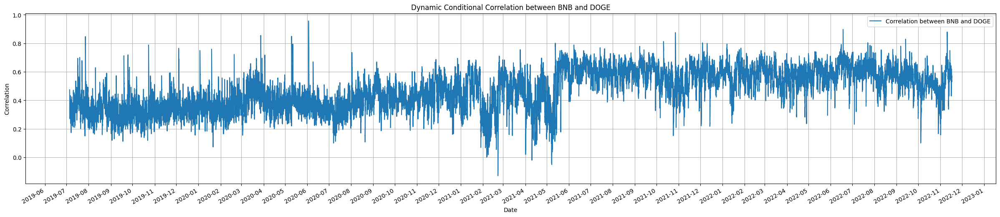

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


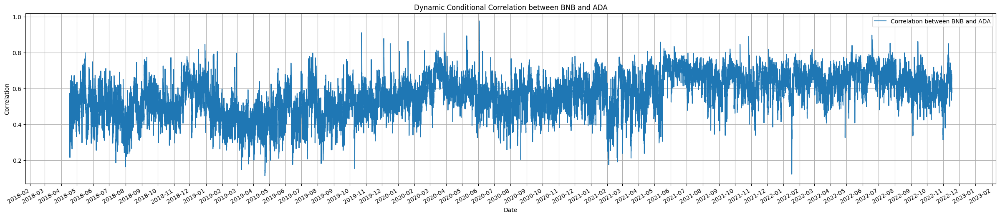

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


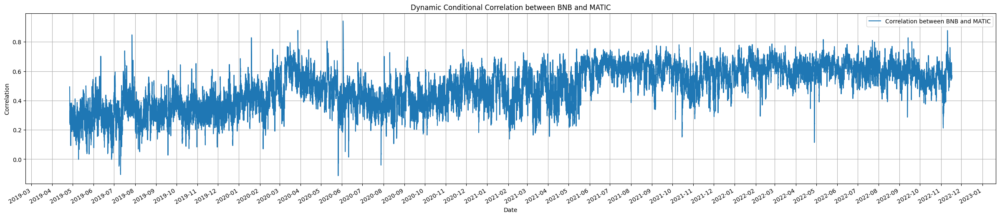

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


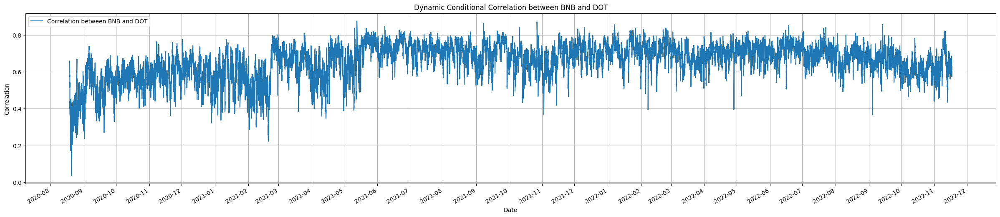

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


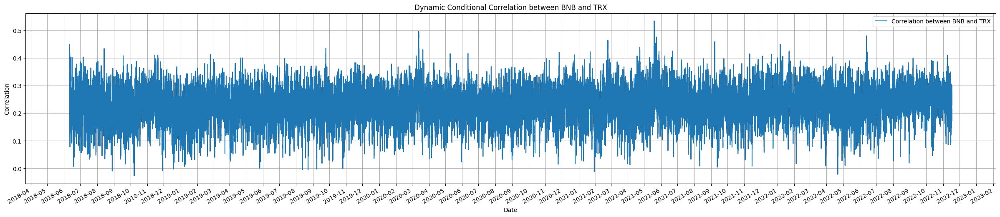

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


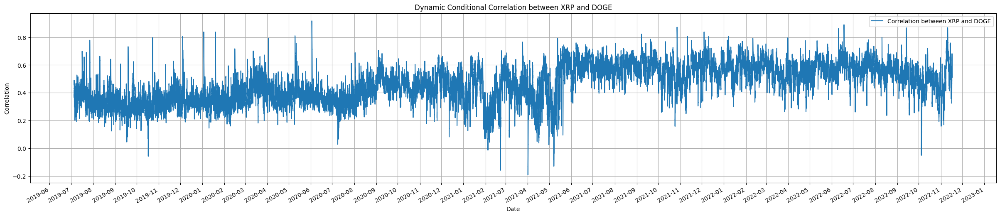

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


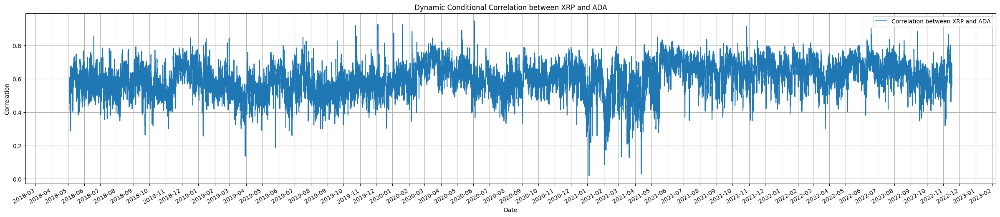

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


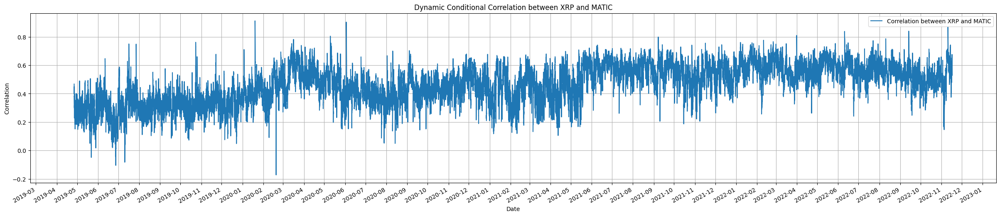

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


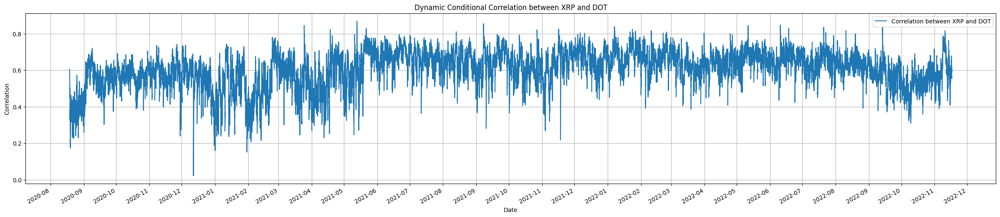

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


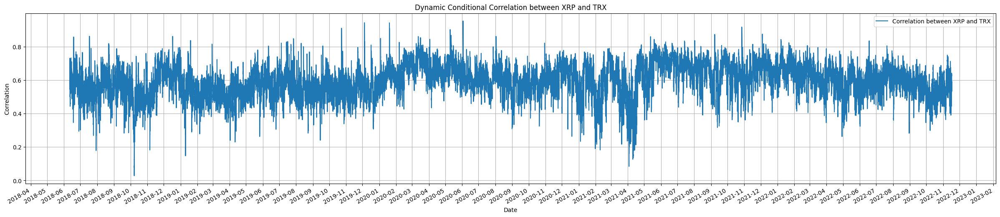

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


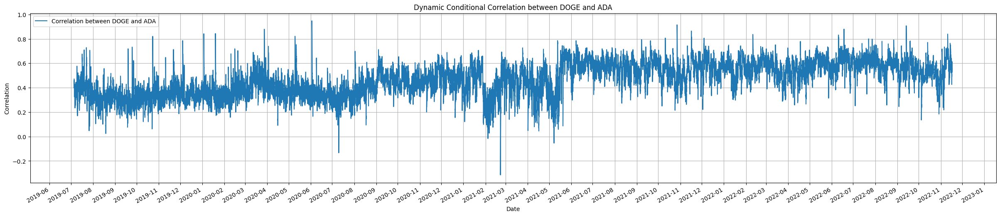

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


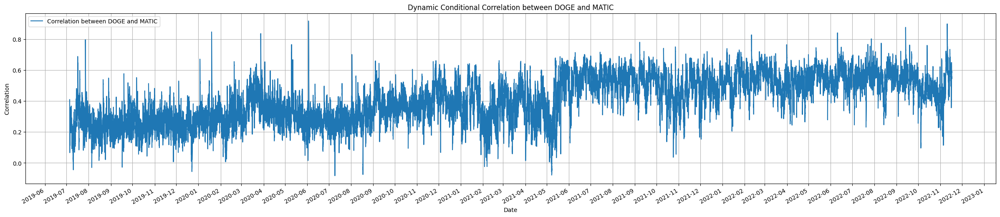

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


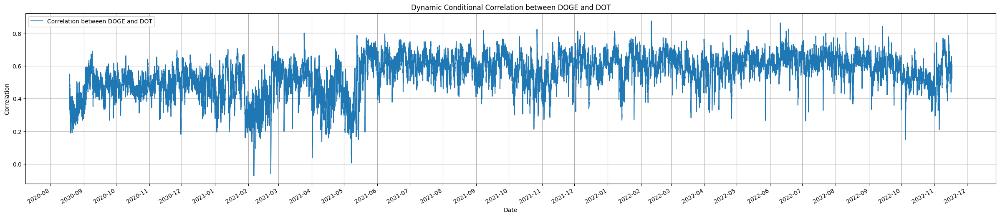

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


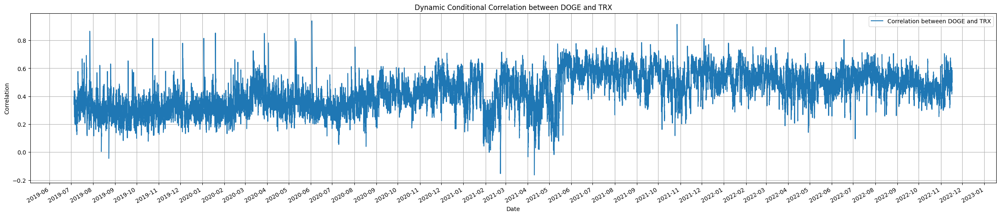

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


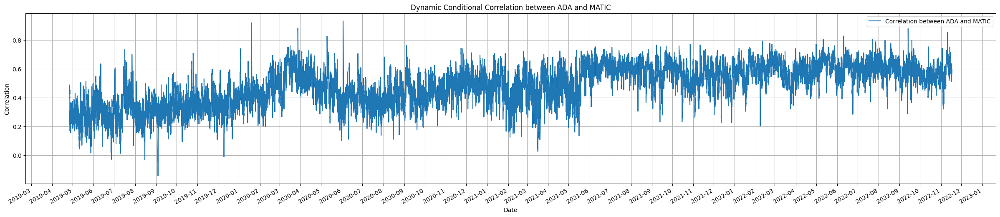

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


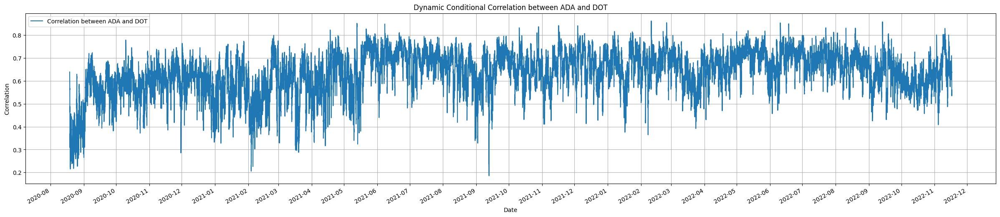

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


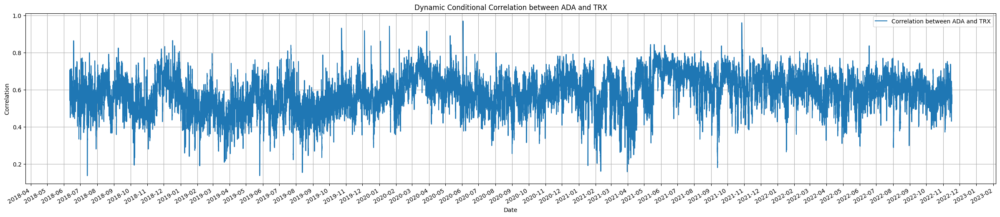

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


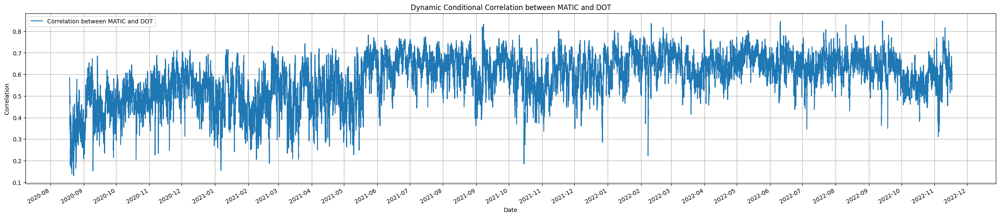

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


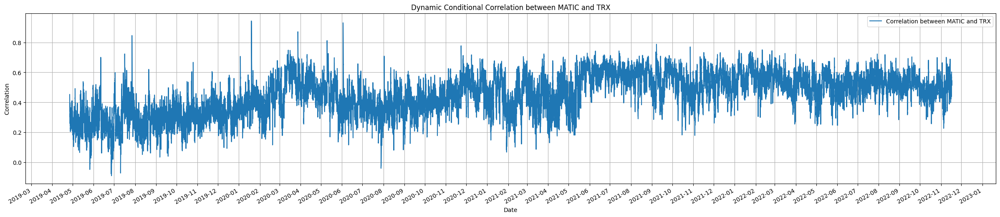

/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/Users/izellale/opt/anaconda3/envs/data_science/lib/python3.9/site-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


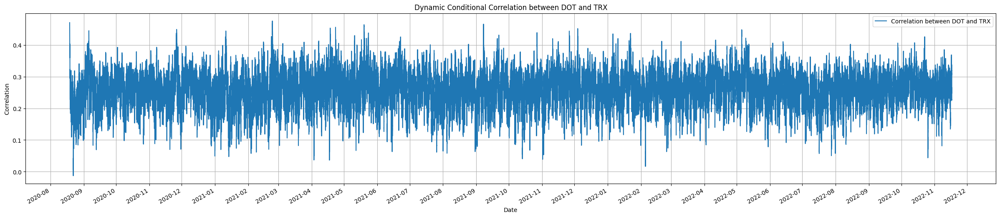

In [242]:
dcc_correlations = {}

crypto_symbols = list(crypto_data.keys())
num_symbols = len(TOP_MKT_CAP)

for i in range(num_symbols - 1):
    for j in range(i+1, num_symbols):
        crypto_1_symbol = crypto_symbols[i]
        crypto_2_symbol = crypto_symbols[j]

        dcc_values = compute_dynamic_conditional_correlation(crypto_1_symbol, crypto_2_symbol)
        dcc_correlations[(crypto_1_symbol, crypto_2_symbol)] = dcc_values

        # Visiluasation
        plt.figure(figsize=(30, 6))
        plt.plot(dcc_values.index, dcc_values, label=f'Correlation between {crypto_1_symbol} and {crypto_2_symbol}')
        plt.title(f'Dynamic Conditional Correlation between {crypto_1_symbol} and {crypto_2_symbol}')
        plt.xlabel('Date')
        plt.ylabel('Correlation')
        plt.legend()
        plt.grid(True)

        # Formatting Date on X-axis
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
        plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
        plt.gcf().autofmt_xdate()  # Rotation

        plt.show()


## 5) Comparaison between DCC and rolling window correlation

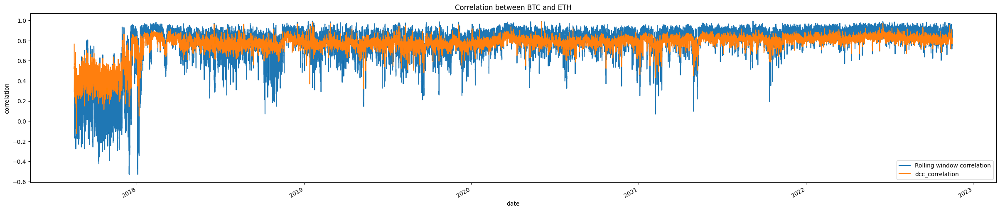

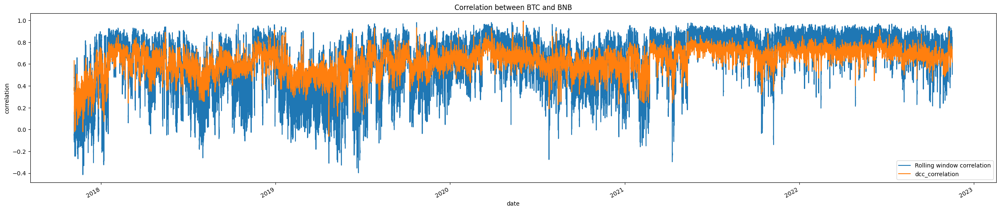

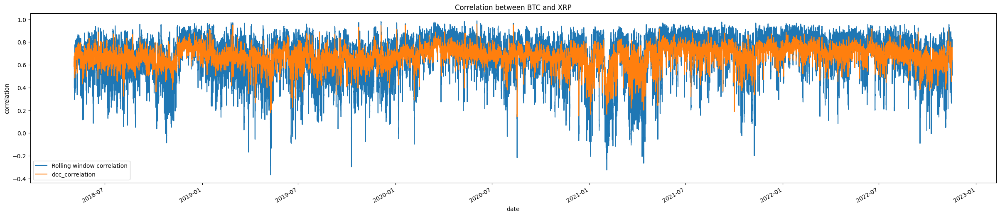

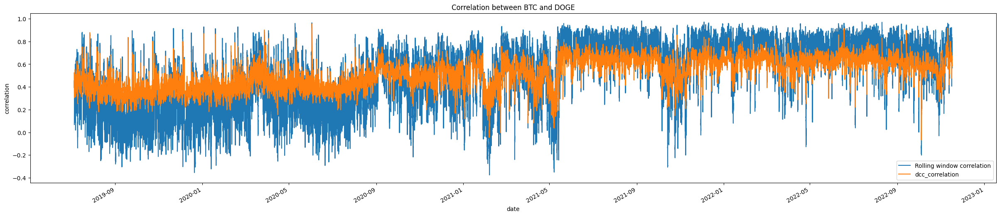

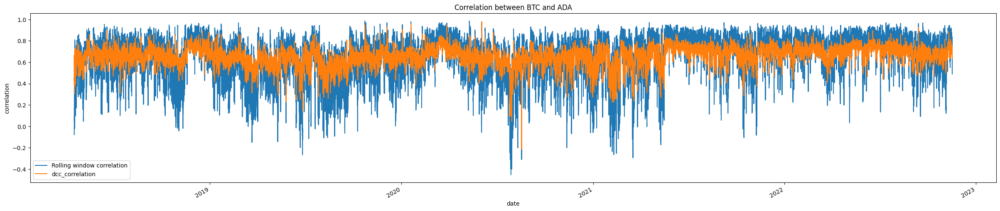

...

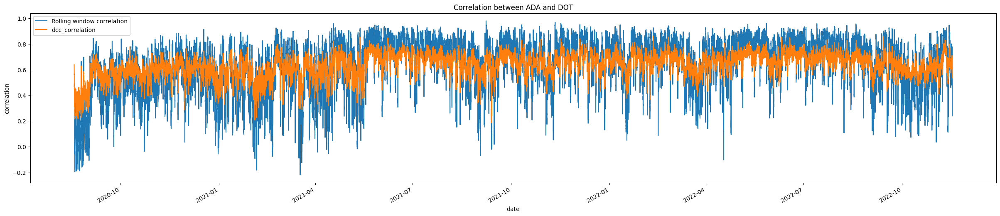

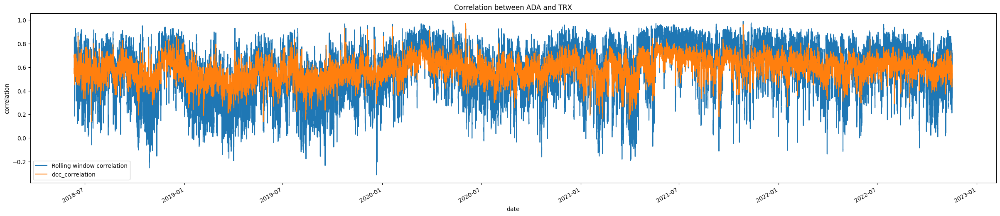

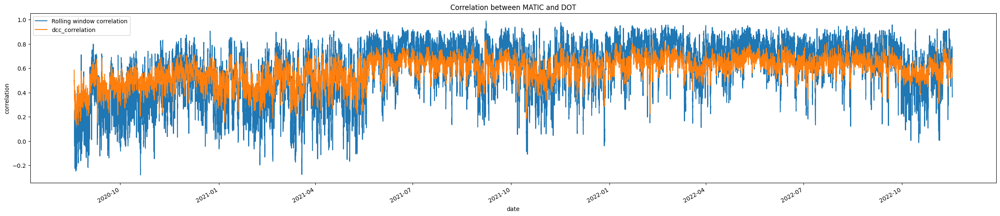

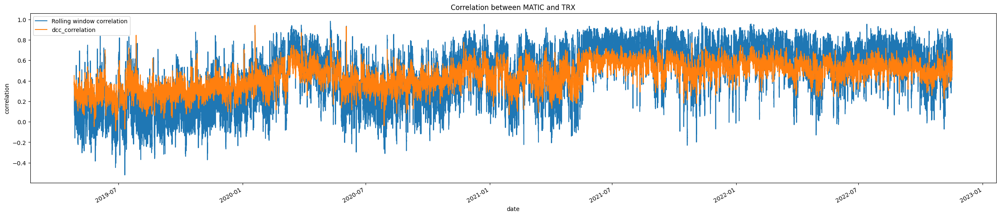

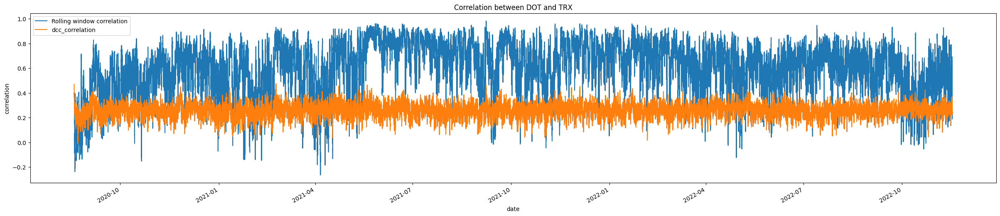

In [243]:
crypto_symbols = list(crypto_data.keys())
num_symbols = len(TOP_MKT_CAP)

for i in range(num_symbols - 1):
    for j in range(i+1, num_symbols):
        crypto_1_symbol = crypto_symbols[i]
        crypto_2_symbol = crypto_symbols[j]

        rol_corr = rolling_correlations[(crypto_1_symbol, crypto_2_symbol)]
        dcc_corr = dcc_correlations[(crypto_1_symbol, crypto_2_symbol)]

        fig, ax = plt.subplots(figsize=(30, 6))
        rol_corr.plot(ax=ax, label='Rolling window correlation')
        dcc_corr.plot(ax=ax, label='Dynamic Conditional Correlation')

        ax.legend()
        ax.set_title(f'Correlation between {crypto_1_symbol} and {crypto_2_symbol}')
        ax.set_xlabel('date')
        ax.set_ylabel('correlation')
        
        plt.show()